# Test lidar calibration

In [1]:
import aeifdataset as ad
from aeifdataset import Dataloader
import numpy as np
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt
import cv2
import scipy.stats as stats
import pandas as pd
import plotly.graph_objects as go
import seaborn as sns
sns.set_theme()

In [2]:
import sys
sys.path.append('..')

from aeifhelpers.visualizers import VehicleCameraViewer, visualize_lidar_points

## Load data

In [3]:
data_path = '../data/' # Path to your .4mse files

# Access the whole dataset
# The Dataloader class loads and manages multiple .4mse files from the specified directory.
dataset = Dataloader(data_path)

# Iterate through Data Records and Frames
frames = []
for datarecord in dataset:
    for frame in datarecord:
        frames.append(frame)

In [4]:
vehicleCameraViewer = VehicleCameraViewer(frames)

frame_idx = 1
lidar_points = frames[frame_idx].vehicle.lidars.TOP
xyz_points = np.stack((lidar_points['x'], lidar_points['y'], lidar_points['z']), axis=-1)

#vehicleCameraViewer.show(show_rear=True)
#visualize_lidar_points(xyz_points, title='LiDAR Point Cloud')

## Test transformations

In [5]:
sensors = {}
sensors['tower_lidar_1'] = frames[frame_idx].tower.lidars.VIEW_1
sensors['tower_lidar_2'] = frames[frame_idx].tower.lidars.VIEW_2
sensors['tower_lidar_upper'] = frames[frame_idx].tower.lidars.UPPER_PLATFORM
sensors['vehicle_lidar_top'] = frames[frame_idx].vehicle.lidars.TOP
sensors['vehicle_lidar_left'] = frames[frame_idx].vehicle.lidars.LEFT
sensors['vehicle_lidar_right'] = frames[frame_idx].vehicle.lidars.RIGHT

tower_labels = ['tower_lidar_1', 'tower_lidar_2', 'tower_lidar_upper']
vehicle_labels = ['vehicle_lidar_top', 'vehicle_lidar_left', 'vehicle_lidar_right']

assert len(tower_labels)+len(vehicle_labels)==len(sensors.keys()), "missing or additional sensors"

In [6]:
def getPointsInRange(points, x_range, y_range, z_range, inverse=False, verbose=True):
    x_min, x_max = x_range
    y_min, y_max = y_range
    z_min, z_max = z_range
    mask = (points[:, 0] >= x_min) & (points[:, 0] <= x_max) & (points[:, 1] >= y_min) & (points[:, 1] <= y_max) & (points[:, 2] >= z_min) & (points[:, 2] <= z_max)
    if inverse:
        mask = ~mask

    if verbose:
        if inverse:
            print('Removing points outside specified range (inverse=%r).' % inverse)
        else:
            print('Keeping points inside specified range (inverse=%r).' % inverse)
        print('Num. of remaining points: %d (of total %d).' % (np.sum(mask), len(mask)))

    return points[mask]

def removeZeros(pts, verbose=True):
    tol = 1e-2
    non_zero_pts = getPointsInRange(pts, (-tol, tol), (-tol, tol), (-tol, tol), inverse=True, verbose=False)
    if verbose:
        print('Non-zero-points:          %d (of total %d).' % (non_zero_pts.shape[0], pts.shape[0]))
    return non_zero_pts

def removeNaN(pts, verbose=True):
    non_nan_pts = pts[~np.isnan(pts).any(axis=1)]
    if verbose:
        print('Non-NaN-points:           %d (of total %d).' % (non_nan_pts.shape[0], pts.shape[0]))
    return non_nan_pts


In [7]:
def collectLidarPointClouds(sensor_labels, sensor_range=None):
    df = None
    for sensor_name in sensor_labels:
        print('Processing sensor: %s' % sensor_name)
        sensor = sensors[sensor_name]
        points = sensor.points.points
        points = np.transpose(np.stack((points['x'], points['y'], points['z'])))
        info = sensor.info
        points = removeZeros(points)
        points = removeNaN(points)
        
        points_in_origin = ad.transform_points_to_origin((points, info))
        if sensor_range is not None:
            points_in_origin = getPointsInRange(points_in_origin, sensor_range['x'], sensor_range['y'], sensor_range['z'])

        df_ = pd.DataFrame(points_in_origin, columns=['x', 'y', 'z'])
        df_['sensor'] = sensor_name
        if df is None:
            df = df_
        else:
            df = pd.concat([df, df_], ignore_index=True)
    return df

sensor_range = { 'x': (-40, 40), 'y': (-40, 40), 'z': (-5, 5) }
df_tower = collectLidarPointClouds(tower_labels, sensor_range=sensor_range)
df_vehicle = collectLidarPointClouds(vehicle_labels, sensor_range=sensor_range)
df_all = pd.concat([df_tower, df_vehicle], ignore_index=True)


Processing sensor: tower_lidar_1
Non-zero-points:          7673 (of total 7673).
Non-NaN-points:           7673 (of total 7673).
Keeping points inside specified range (inverse=False).
Num. of remaining points: 7673 (of total 7673).
Processing sensor: tower_lidar_2
Non-zero-points:          5774 (of total 5774).
Non-NaN-points:           5774 (of total 5774).
Keeping points inside specified range (inverse=False).
Num. of remaining points: 5479 (of total 5774).
Processing sensor: tower_lidar_upper
Non-zero-points:          86708 (of total 131072).
Non-NaN-points:           86708 (of total 86708).
Keeping points inside specified range (inverse=False).
Num. of remaining points: 50773 (of total 86708).
Processing sensor: vehicle_lidar_top
Non-zero-points:          74339 (of total 131072).
Non-NaN-points:           74339 (of total 74339).
Keeping points inside specified range (inverse=False).
Num. of remaining points: 60332 (of total 74339).
Processing sensor: vehicle_lidar_left
Non-zero-poi

In [8]:
# Create a plotly 3D scatter plot
def show_lidars_dataframe(df, color_scheme=None, size=1.0, opacity=0.5):
    """ Display lidar point clouds stored as a pandas dataframe.

    The dataframe df is supposed to have columns 'x', 'y', 'z', and 'sensor', where 'sensor' (with the optional color scheme) indicates the marker color.
    """
    #assert len(df['sensor'].unique()) <= 3, "Too many sensors to display. Please reduce the number of sensors or use visualize_lidar_points (without pandas dataframe)."

    if color_scheme is None:
        color_scheme = {
            'tower_lidar_1': 'blue',  
            'tower_lidar_2': 'red', 
            'tower_lidar_upper': 'yellow', 
            'vehicle_lidar_top': 'purple', 
            'vehicle_lidar_left': 'orange',
            'vehicle_lidar_right': 'cyan'
        }

    handles = []
    for name in df['sensor'].unique():
        handles.append(mpatches.Patch(color=color_scheme[name], label=name))

    plt.figure()
    plt.legend(handles=handles);
    plt.axis('off');

    data = [
        go.Scatter3d(
            x=df['x'],
            y=df['y'],
            z=df['z'],
            mode='markers',
            marker=dict(
                size = size,
                color = df['sensor'].apply(lambda x: color_scheme[x]),
                opacity = opacity
            )
        )
    ]

    fig = go.Figure(data=data)

    # Update the layout for better visualization
    fig.update_layout(
        scene=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z',
            aspectmode='data'
        ),
        width=800,
        height=700,
        title='all lidar points in origin'
    )
    fig.show()

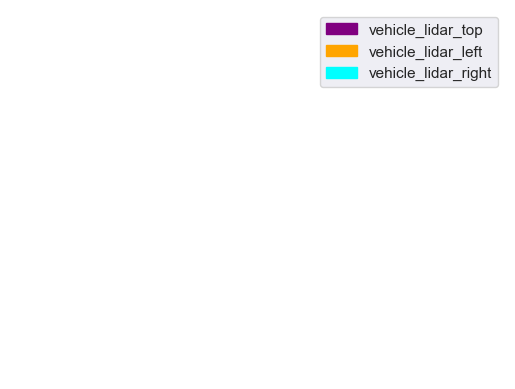

In [9]:
show_lidars_dataframe(df_vehicle)
#show_lidars_dataframe(df_tower)
#show_lidars_dataframe(df_all)

## Estimate ground plane from top vehicle lidar

In [10]:
df_vehicle_top = df_vehicle[df_vehicle.sensor=='vehicle_lidar_top']
xyz_points = df_vehicle_top[['x', 'y', 'z']].to_numpy()

Keeping points inside specified range (inverse=False).
Num. of remaining points: 21276 (of total 60332).
Non-zero-points:          21276 (of total 21276).
Non-NaN-points:           21276 (of total 21276).
Removing points outside specified range (inverse=True).
Num. of remaining points: 21276 (of total 21276).


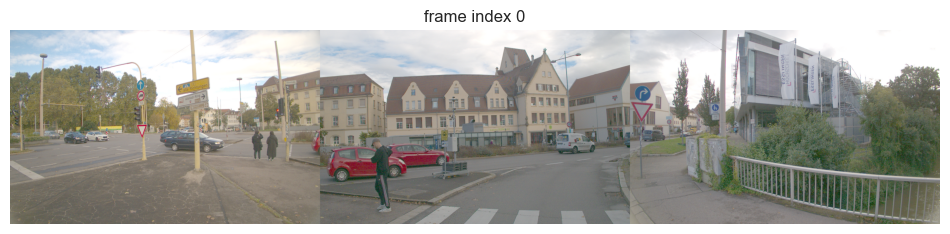

In [11]:
# get non-zero points in the range of the vehicle
potential_ground_points = getPointsInRange(xyz_points, (-30, 30), (-30, 30), (-4, -1.5))
potential_ground_points = removeZeros(potential_ground_points)
potential_ground_points = removeNaN(potential_ground_points)

# There are some points on the ego vehicle itself. Remove them.
potential_ground_points = getPointsInRange(potential_ground_points, (-1.2, 0.7), (-1.0, 1.0), (-0.5, 0.1), inverse=True)

vehicleCameraViewer.show()
visualize_lidar_points(potential_ground_points, title='LiDAR Point Cloud')

In [12]:
class BinSampler():
    """
    Partition the vehicle points into bins on the x/y-plane and sample from them.
    """
    def __init__(self, vehicle_points, num_bins=10):
        """
        Generate equally spaced bins on the x/y-plane and store the indices of the points in each bin.
        """
        ret = stats.binned_statistic_2d(vehicle_points[:,0], vehicle_points[:,1], vehicle_points[:,2], statistic='count', bins=num_bins)
        self.bins_with_indices = []
        for bin_nr in range(min(ret.binnumber), max(ret.binnumber)):
            mask = ret.binnumber == bin_nr
            if np.sum(mask) > 0:
                self.bins_with_indices.append(np.where(mask)[0])
        assert len(self.bins_with_indices) > 0, 'No non-empty bins found.'

    def sample(self, num_samples=3):
        """
        Randomly select different bins and sample one point from each bin.
        """
        assert num_samples <= len(self.bins_with_indices), 'Number of samples exceeds number of non-empty bins.'
        idx = []
        bin_indices = np.random.choice(len(self.bins_with_indices), num_samples, replace=False)
        for bin_idx in bin_indices:
            idx.append(self.bins_with_indices[bin_idx][np.random.choice(len(self.bins_with_indices[bin_idx]), 1)[0]])
        return idx

In [13]:
def TLS(pts):
    """
    Use total least squares to compute a plane that 
    - passes through the center of the given data points and 
    - has normal vector n
    """ 
    center = np.mean(pts, axis=0)
    M = pts - center 
    MTM = np.dot(np.transpose(M), M)
    U, S, Vt = np.linalg.svd(MTM) 
    n = Vt[-1] # eigenvector corresponding to the least eigenvalue
    return n, center

def TLS_distance(n, center, pts):
    return np.dot(n, np.transpose(pts-center))

def GaussMarkovModel(pts):
    assert pts.shape[1] == 3, 'input should be Nx3 matrix'
    N = pts.shape[0]

    H = np.zeros((N, 3))
    H[:,:2] = pts[:,:2]
    H[:,2] = 1

    y_hat = np.zeros((N, 1))
    y_hat[:,0] = pts[:,2]

    return H, y_hat

def computeResidual(pts, z_hat):
    H, y_hat = GaussMarkovModel(pts)
    res = np.dot(H, z_hat) - y_hat
    return res

def ransac(pts, num_iter=50, inlier_threshold=0.1):
    best_inliers = []
    best_z_hat = None
    best_med_res = np.inf

    binSampler = BinSampler(pts)

    for _ in range(num_iter):
        #idx = np.random.choice(pts.shape[0], 3, replace=False)
        idx = binSampler.sample(num_samples=3)

        H, y_hat = GaussMarkovModel(pts[idx,:])
        z_hat = np.dot(np.linalg.pinv(H), y_hat)
        res = computeResidual(pts, z_hat)
        med_res = np.median(np.abs(res))
        inliers = np.where(np.abs(res) < inlier_threshold)[0]

        #if med_res < best_med_res: # for LMedS
        if len(inliers) > len(best_inliers): # for standard RANSAC
            best_inliers = inliers
            best_z_hat = z_hat
            best_med_res = med_res

    return best_z_hat, best_med_res, best_inliers

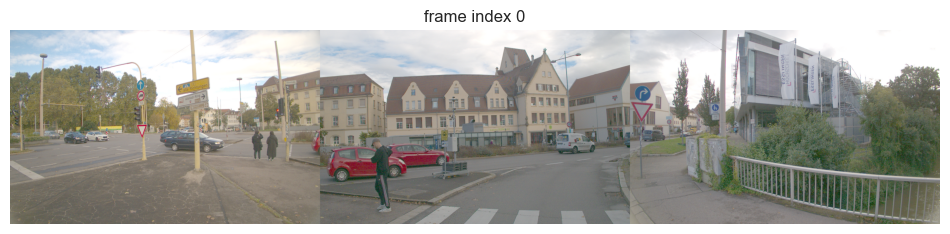

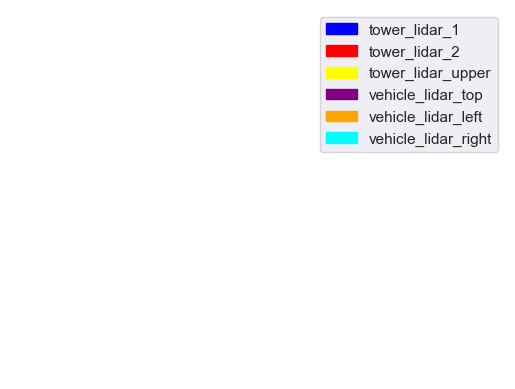

In [14]:
# RANSAC to find robust guess for ground plane
best_z_hat, best_med_res, best_inliers = ransac(potential_ground_points)

# total least squares on all inliers to refine ground plane
n, center = TLS(potential_ground_points[best_inliers])

xyz_points = df_all[['x', 'y', 'z']].to_numpy()
df_all['height'] = TLS_distance(n, center, xyz_points)

df_all_filtered = df_all[np.abs(df_all['height']) > 0.15]

vehicleCameraViewer.show()
show_lidars_dataframe(df_all_filtered, size=1, opacity=0.8)


# Things to note:

1. vehicle_lidar_left is not aligned with vehicle_lidar_right and vehicle_lidar_top 
2. tranformation from tower to vehicle still missing!